In [88]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
import cv2 as cv
from tensorflow import keras
from keras.layers import Normalization,Dense,InputLayer,Conv2D,MaxPool2D,Flatten,BatchNormalization
from keras.losses import BinaryCrossentropy
from keras.optimizers import Adam
#pip install tensorflow_datasets

In [68]:
#load is used to load the dataset
#the data set will be downloaded in your system in this folder-> home/saikiran/tensorflow_datasets/downloads/extracted->for your system location will be visible in output->"home/saikiran" this part changes
#after downloading once this load uses only that data so it doesnt download the data again

dataset,dataset_info = tfds.load('malaria',with_info=True,as_supervised=True,shuffle_files=True,split=['train'])

In [69]:
""" dataset,dataset_info = tfds.load('malaria',with_info=True,as_supervised=True,shuffle_files=True)
k = 0
for data in dataset['train']:
    k+=1
    if k == 6:
        break
    img,label = data
    plt.imshow(img.numpy())
    plt.show() """


" dataset,dataset_info = tfds.load('malaria',with_info=True,as_supervised=True,shuffle_files=True)\nk = 0\nfor data in dataset['train']:\n    k+=1\n    if k == 6:\n        break\n    img,label = data\n    plt.imshow(img.numpy())\n    plt.show() "

2023-09-12 16:16:48.952343: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_3' with dtype int64 and shape [4]
	 [[{{node Placeholder/_3}}]]
2023-09-12 16:16:48.953688: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_3' with dtype int64 and shape [4]
	 [[{{node Placeholder/_3}}]]


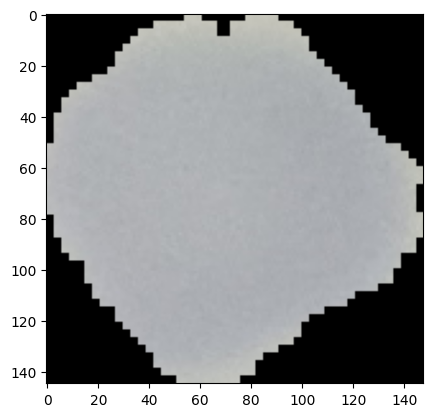

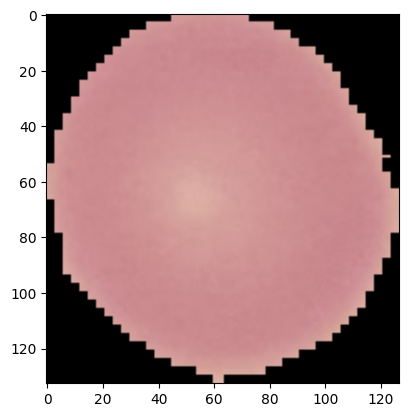

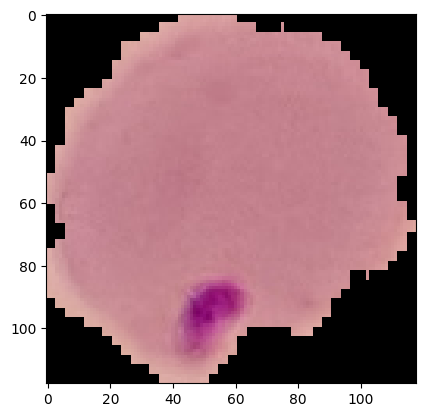

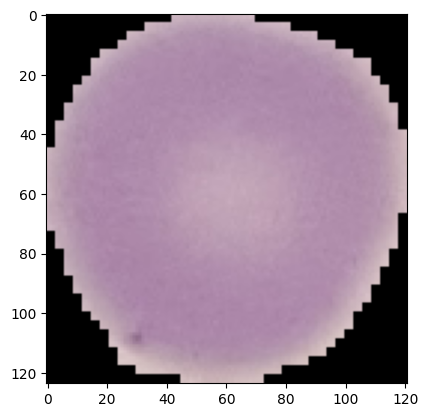

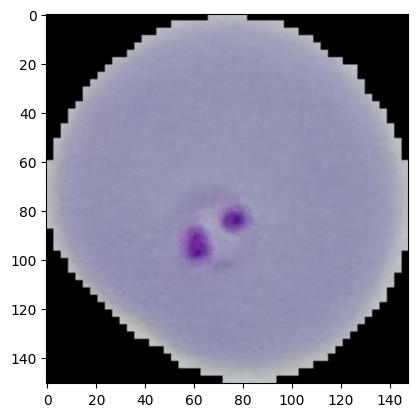

In [70]:
printSet = dataset[0]
k = 0
for data_point in printSet.take(5):
    k+=1  # Take the first 5 data points
    if k == 6:
        break
    image_data = data_point[0]
    label = data_point[1]
    plt.imshow(image_data.numpy())
    plt.show()

In [71]:
def splits(dataset,train_ratio,val_ratio,test_ratio):
    dataset_size = len(dataset)
    #used on dataset API
    #skip(n) ->skips until n and takes everything from next element
    #take(n) -> takes first n elements

    print(dataset_size)
    train_dataset = dataset.take(int(train_ratio*dataset_size))
    print(list(dataset.as_numpy_iterator()))

    val_1_dataset = dataset.skip(int(train_ratio*dataset_size))
    val_dataset = val_1_dataset.take(int(val_ratio*dataset_size))

    test_dataset = val_1_dataset.skip(int(val_ratio*dataset_size))
    return train_dataset,val_dataset,test_dataset    

In [72]:
train_ratio = 0.9
val_ratio = 0.05
test_ratio = 0.05

train_dataset,val_dataset,test_dataset = splits(dataset[0],train_ratio,val_ratio,test_ratio)

27558


2023-09-12 16:16:50.516304: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_1' with dtype string and shape [4]
	 [[{{node Placeholder/_1}}]]
2023-09-12 16:16:50.517434: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int64 and shape [4]
	 [[{{node Placeholder/_4}}]]


[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 0), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
      

In [73]:
#we obtain dataset as a dictionary
#for data in dataset[0].take(1):
#    print(data)


In [74]:
print(dataset_info.features['label'])
#how?

ClassLabel(shape=(), dtype=int64, num_classes=2)


In [75]:
dataset[0]

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [76]:
train_dataset

<_TakeDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

2023-09-12 16:17:13.688180: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [4]
	 [[{{node Placeholder/_0}}]]
2023-09-12 16:17:13.692604: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int64 and shape [4]
	 [[{{node Placeholder/_4}}]]


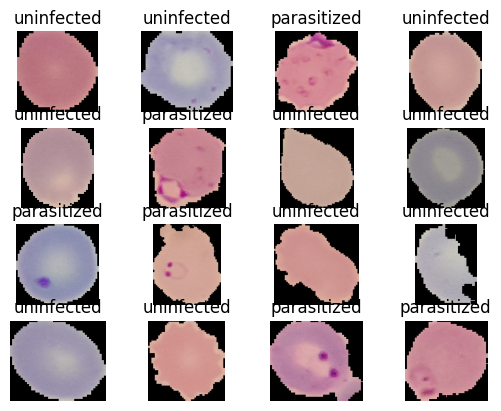

In [77]:
for i,(image,label) in enumerate(train_dataset.take(16)):
    ax = plt.subplot(4,4,i+1)
    plt.imshow(image)
    plt.title(dataset_info.features['label'].int2str(label))
    plt.axis('off')

### Building the CNN
### Note here I am telling how to work with tensorflow datasets,I will also tell how to work with normal datasets

In [78]:
IMG_SIZE = 224
def resize_rescale(image,label):
    return tf.image.resize(image,(IMG_SIZE,IMG_SIZE))/255.0,label

In [79]:
train_dataset

<_TakeDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [80]:
train_dataset = train_dataset.map(resize_rescale)
val_dataset = val_dataset.map(resize_rescale)
test_dataset = test_dataset.map(resize_rescale)

In [81]:
train_dataset

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [82]:
train_dataset = train_dataset.shuffle(buffer_size = 8,reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)
val_dataset = val_dataset.shuffle(buffer_size = 8,reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

In [83]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [89]:
model = keras.Sequential([
    InputLayer(input_shape = (IMG_SIZE,IMG_SIZE,3)),
    Conv2D(filters = 6,kernel_size = 5,strides = 1,padding = 'valid',activation = 'sigmoid'),
    BatchNormalization(),
    MaxPool2D(pool_size=2,strides=2),
    Conv2D(filters = 16,kernel_size = 5,strides = 1,padding = 'valid',activation = 'sigmoid'),
    BatchNormalization(),
    MaxPool2D(pool_size=2,strides=2),
    Flatten(),
    Dense(100,activation = 'sigmoid'),
    BatchNormalization(),
    Dense(10,activation = 'sigmoid'),
    Dense(1,activation = 'sigmoid'),
])
""" model = keras.Sequential([
    InputLayer(input_shape = (IMG_SIZE,IMG_SIZE,3)),
    Conv2D(filters = 6,kernel_size = 5,strides = 1,padding = 'valid',activation = 'relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=2,strides=2),
    Conv2D(filters = 16,kernel_size = 5,strides = 1,padding = 'valid',activation = 'relu'),
    BatchNormalization(),
    MaxPool2D(pool_size=2,strides=2),
    Flatten(),
    Dense(100,activation = 'relu'),
    BatchNormalization(),
    Dense(10,activation = 'relu'),
    Dense(1,activation = 'sigmoid'),
]) """
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_14 (Conv2D)          (None, 220, 220, 6)       456       
                                                                 
 batch_normalization (BatchN  (None, 220, 220, 6)      24        
 ormalization)                                                   
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 110, 110, 6)      0         
 g2D)                                                            
                                                                 
 conv2d_15 (Conv2D)          (None, 106, 106, 16)      2416      
                                                                 
 batch_normalization_1 (Batc  (None, 106, 106, 16)     64        
 hNormalization)                                                 
                                                      

In [92]:
model.compile(optimizer = Adam(learning_rate=0.1),
              loss = BinaryCrossentropy(),
              metrics='accuracy')

In [93]:
no_of_epochs = 2
history = model.fit(train_dataset,validation_data=val_dataset,epochs = 2,verbose = 1)

Epoch 1/2
776/776 [==============================] - ETA: 0s - loss: 0.7026 - accuracy: 0.4965

2023-09-12 17:15:42.513245: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may take a while): 1 of 8
2023-09-12 17:15:42.538610: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:417] Shuffle buffer filled.


776/776 [==============================] - 1492s 2s/step - loss: 0.7026 - accuracy: 0.4965 - val_loss: 0.6957 - val_accuracy: 0.4931
Epoch 2/2
227/776 [=======>......................] - ETA: 16:52 - loss: 0.7003 - accuracy: 0.5012

### Performance Measurement

In [ ]:
test_dataset = test_dataset.batch(1)

In [ ]:
model.evaluate(test_dataset)

In [ ]:
parasite_or_not(model.predict(test_dataset.take(1))[0][0])

In [ ]:
def parasite_or_not(x):
    if(x<0.5):
        return str('P')
    else:
        return str('U')

In [ ]:
for i,(image,label) in enumerate(train_dataset.take(9)):
    ax = plt.subplot(3,3,i+1)
    plt.imshow(image[0])
    plt.title(str(parasite_or_not(label.numpy()[0]))) + ":" + str(parasite_or_not(model.predict(image)[0][0]))
    plt.axis('off')